In [1]:
import sys
sys.path.append('..\\..\\src')
import matplotlib.pyplot as plt
import numpy as np
import ruptures as rpt
import welly
import pandas as pd
import cp_comparitor as cp_Comp
import change_point_tools as cp_Tools
import well_tools as wtool
import test_func as tst
import scipy.stats as stats

#### Loading Wells into memory

In [2]:
#setting global variables for the ruptures PELT parameters pen and min_size 
path = 'C:\\Users\\ada55080\\git\different_bayes\\volve_well_data\\'
f1A = welly.Well.from_las(path + '15_9-F-1A\\15_9-F-1A.las')
f1B = welly.Well.from_las(path + '15_9-F-1B\\15_9-F-1B.las')
f1C = welly.Well.from_las(path + '15_9-F-1C\\15_9-F-1C.las')
f11A = welly.Well.from_las(path + '15_9-F-11A\\15_9-F-11A.las')
f11B = welly.Well.from_las(path + '15_9-F-11B\\15_9-F11B.las')

Defining some functions that are not yet implemented in the tools packages above 
(probably because they are not yet well documented :( 

In [3]:
#wtool = well_tools.well_tools()

def spearman_offset(comparitee_vector, comparitor_vector, **kwargs):
    _window = kwargs.get('window')
    _match_param = kwargs.get('param')
    stat = []
    pvalue = []
    tee = comparitee_vector
    tor = comparitor_vector

    if len(tor)<len(tee[:_window]):
        print("Comparitor is shorter than comparitee, this won't do, try a shorter sequence") 
    else:
        for i in range(len(tor)-len(tee)):
            SigRes = (stats.spearmanr(tor[i:i+_window],tee[:_window]))
            stat.append(SigRes.statistic)
            pvalue.append(SigRes.pvalue)
        statAray = np.array(stat)
        statAray = np.nan_to_num(statAray, nan=0.0)
        
        pvalueAray = np.array(pvalue)
        pvalueAray = np.nan_to_num(pvalueAray, nan=1)
        print('statArgmax= ' + str(statAray.argmax()) + ' val ' + str(statAray[statAray.argmax()]))
        print('pvalArgmin= ' + str(pvalueAray.argmin()) + ' val ' + str(pvalueAray[pvalueAray.argmin()]))
        #print
    if _match_param == 'pval':
        return pvalueAray.argmin()
    elif _match_param == 'sval':
        return statAray.argmax()
    else:
        return pvalueAray.argmin()

    

In [ ]:
''' replace NaN's with a choice between global / local / or a linear interpolation between gaps '''
    
import numpy as np
from scipy.interpolate import interp1d

def replace_nans(array, method='global_average', window_size=3):
    """
    Replace NaN values in an array with specified method.
    
    Parameters:
        array (numpy.ndarray): Input array containing NaN values.
        method (str): Method to replace NaNs. Options are 'global_average',
                      'local_average', or 'linear_interpolation'.
                      Default is 'global_average'.
        window_size (int): Size of the window for local averaging. Applicable
                           only if method is 'local_average'. Default is 3.
    
    Returns:
        numpy.ndarray: Array with NaN values replaced.
    """
    if method == 'global_average':
        # Compute the global average excluding NaN values
        global_avg = np.nanmean(array)
        # Replace NaNs with the global average
        array[np.isnan(array)] = global_avg
    
    elif method == 'local_average':
        # Replace NaNs with local average within a window
        for i in range(len(array)):
            if np.isnan(array[i]):
                # Calculate the indices for the window around the NaN
                lower_bound = max(0, i - window_size)
                upper_bound = min(len(array), i + window_size + 1)
                
                # Compute the local average excluding NaN values
                local_avg = np.nanmean(array[lower_bound:upper_bound])
                # Replace NaN with the local average
                array[i] = local_avg
    
    elif method == 'linear_interpolation':
        # Create a mask of non-NaN values
        mask = ~np.isnan(array)
        # Create a linear interpolation function
        interp_func = interp1d(np.where(mask)[0], array[mask])
        # Replace NaNs with interpolated values
        array[np.isnan(array)] = interp_func(np.where(np.isnan(array))[0])
    
    else:
        raise ValueError("Invalid method. Please choose 'global_average', "
                         "'local_average', or 'linear_interpolation'.")
    
    return array

In [4]:
from itertools import product

def generate_progressive_combinations(*number_sets):
    combinations = list(product(*number_sets))
    progressive_combinations = []
    for combination in combinations:
        is_progressive = True
        for i in range(len(combination) - 1):
            if combination[i+1] <= combination[i]:
                is_progressive = False
                break
        if is_progressive:
            progressive_combinations.append(combination)

    return progressive_combinations

# Example usage:
set1 = [1, 2, 3]
set2 = [2, 3, 4]

In [5]:
def normalize_array(arr, low_clip, high_clip): 
    '''created through CHATGPT-4
    text input:

    build a python function that normalizes a numpy 
    array to values between zero and one as inputs takes in an 
    array to normalize, and two clipping percentage parameters 
    one for the high end and one for the low end'''

    # Calculate the lower and upper percentile values
    low_value = np.percentile(arr, low_clip)
    high_value = np.percentile(arr, 100 - high_clip)
    
    # Clip the array values based on the percentiles
    clipped_arr = np.clip(arr, low_value, high_value)
    
    # Normalize the clipped array to values between zero and one
    normalized_arr = (clipped_arr - low_value) / (high_value - low_value)
    
    return normalized_arr

In [6]:
def replace_outliers_with_local_average(curve, percent, window_size):
    # Load the well log data
    #w = 

    # Get the curve data
    

    # Calculate the lower and upper percentile values
    low_value = np.percentile(curve, percent)
    high_value = np.percentile(curve, 100 - percent)

    # Identify outlier data points
    outliers = np.logical_or(curve < low_value, curve > high_value)

    # Replace outliers with local average
    curve[outliers] = np.convolve(curve, np.ones(window_size)/window_size, mode='same')[outliers]

    # Update the well log curve with the replaced values
    w = curve

    return w

The following dictionaries are #global# place holder variables.

In [7]:


#Rolling average parameters

#window = 30
#periods = 3

#setting global variables for the ruptures PELT parameters pen and min_size 
RHOB_glob_pen = 0.5
RHOB_glob_min = 10

NPHI_glob_pen = 0.1
NPHI_glob_min = 10

GR_glob_pen = 1300
GR_glob_min = 10


#string label varables
dataGR = "GR"
dataRHOB = "RHOB"
dataNPHI = "NPHI"

#Well names lists for automation
_wellnames = ['df_f1A', 'df_f1B', 'df_f1C', 'df_f11A', 'df_f11B']
_wells = [f1A, f1B, f1C, f11A, f11B]
_log_list = ['NPHI','RHOB','GR','DT','PEF']
_log_list_nodt = ['NPHI','RHOB','GR','PEF']

#Dictionaries for log extents

_logname_extent_min = {'f1A' : 2620, 'f1B' : 3100 , 'f1C': 3100 , 'f11A' : 2600 , 'f11B': 3200 }
_logname_extent_max = {'f1A' : 3600, 'f1B' : 3400 , 'f1C': 4100 , 'f11A' : 3700 , 'f11B': 4550 }
_log_extent_min = {0 : 2620, 1 : 3100 , 2: 3100 , 3 : 2600 , 4: 3200 }
_log_extent_max = {0: 3600, 1 : 3400 , 2: 4100 , 3 : 3700 , 4: 4550 }


#### Loading Volve Well logs... These logs do not have any spacial awareness so everthing is relative to the Measured Depth
in the borehole future implementations will need some 3D awareness to be convincing, as these particular wells are 
controlled for depth and are clearly in the same basin they can work for this illustration

In [8]:
# Writing well log values to dataframe, index is MD(measured depth)
df_f1A = _wells[0].df(_log_list)
df_f1B = _wells[1].df(_log_list)
df_f1C = _wells[2].df(_log_list)
df_f11A = _wells[3].df(_log_list)
df_f11B = _wells[4].df(_log_list)


'''Un-Comment for Building dataframes with Rolling Averages'''
# data_f1A = wtool.compute_all_rolling_avg(df_f1A, window=30, periods=3)
# data_f1B = wtool.compute_all_rolling_avg(df_f1B, window=30, periods=3)
# data_f1C = wtool.compute_all_rolling_avg(df_f1C, window=30, periods=3)
# data_f11A = wtool.compute_all_rolling_avg(df_f11A, window=30, periods=3)
# data_f11B = wtool.compute_all_rolling_avg(df_f11B, window=30, periods=3)


c:\Users\ada55080\.conda\envs\sdt\lib\site-packages\welly\curve.py:470: FutureWarning: Index.is_numeric is deprecated. Use pandas.api.types.is_any_real_numeric_dtype instead
  if self.df.index.is_numeric() and not self.df.index.empty:
c:\Users\ada55080\.conda\envs\sdt\lib\site-packages\welly\curve.py:470: FutureWarning: Index.is_numeric is deprecated. Use pandas.api.types.is_any_real_numeric_dtype instead
  if self.df.index.is_numeric() and not self.df.index.empty:
c:\Users\ada55080\.conda\envs\sdt\lib\site-packages\welly\curve.py:470: FutureWarning: Index.is_numeric is deprecated. Use pandas.api.types.is_any_real_numeric_dtype instead
  if self.df.index.is_numeric() and not self.df.index.empty:
c:\Users\ada55080\.conda\envs\sdt\lib\site-packages\welly\curve.py:470: FutureWarning: Index.is_numeric is deprecated. Use pandas.api.types.is_any_real_numeric_dtype instead
  if self.df.index.is_numeric() and not self.df.index.empty:
c:\Users\ada55080\.conda\envs\sdt\lib\site-packages\welly\cu

<Axes: xlabel='DEPTH'>

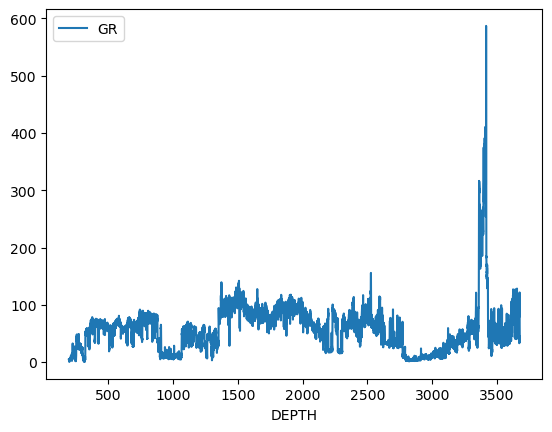

In [14]:
'''Ploting to check everything is importing correctly'''

#df_f1A[['GR']].plot()


### building changepoint probability for the input well logs

In [ ]:
'''Testing Bayesian changepoint method, and populating well dataframe'''
# data_f1A['Roll_Avg_GR'] = wtool.fill_out_data_ends(data_f1A['Roll_Avg_GR'].values)

# data_f1A['Roll_Avg_GR'] = wtool.replace_nans(data_f1A['Roll_Avg_GR'].values, method='linear_interpolation', window_size=200)

# data_f1A['CPprob_GR'] = cp_Tools.bayes_offline_split(data_f1A['Roll_Avg_GR'].values, sequence_length=1000)



# data_f1A['GR'] = wtool.fill_out_data_ends(data_f1A['GR'].values)

# data_f1A['GR'] = wtool.replace_nans(data_f1A['GR'].values, method='linear_interpolation', window_size=200)

# data_f1A['CPprob_GRraw'] = cp_Tools.bayes_offline_split(data_f1A['GR'].values, sequence_length=1000)

In [19]:
def df_CP_Prob(df, log_dict=[], label='CP_Prob_', method='local_average', window_size=200, sequence_length=1000):
    for log in log_dict:
        print(log+' finding changepoints')
        labl = label+log
        df[log] = wtool.fill_out_data_ends(df[log].values)

        df[log] = wtool.replace_nans(df[log].values, method=method, window_size=window_size)
        
        df[labl] = cp_Tools.bayes_offline_split(df[log].values, sequence_length=sequence_length)

        

In [56]:
''' ! ! ! AUCHTUNG ! ! !  ***** This cell will take a bit of time to compute, *****  

time for coffee break? or just take your eyes off the screen.

for me each took about 8 min with sequence_length=1000 I have them individually commented for convenience'''

_sequence_length = 1000 # the method will split the dataset into equal chunks to compute their probabilities separately, mostly for computational efficiency
_window_size = 200 # when filling missing data with the 'local_average' method, this is the parameter fed into np.convolve to impute the missing vals


#df_CP_Prob(df_f1A, log_dict=_log_list, label='CP_Prob_', method='local_average', window_size=_window_size, sequence_length=sequence_length)

#df_CP_Prob(df_f1B, log_dict=_log_list, label='CP_Prob_', method='local_average', window_size=_window_size, sequence_length=sequence_length)

#df_CP_Prob(df_f1C, log_dict=_log_list_nodt, label='CP_Prob_', method='local_average', window_size=_window_size, sequence_length=sequence_length)

#df_CP_Prob(df_f11A, log_dict=_log_list, label='CP_Prob_', method='local_average', window_size=_window_size, sequence_length=sequence_length)

#df_CP_Prob(df_f11B, log_dict=_log_list_nodt, label='CP_Prob_', method='local_average', window_size=_window_size, sequence_length=sequence_length)

df_CP_Prob(df_f1A, log_dict=['GR'], label='CP_Prob_', method='local_average', window_size=_window_size, sequence_length=_sequence_length)




#### template ##### df_CP_Prob(df, log_dict=[], label='CP_Prob_', method='local_average', window_size=_window_size, sequence_length=_sequence_length)






GR finding changepoints
None None None None None
completed segment 1 from0: 1000 of 35361
None None None None None
completed segment 2 from1000: 2000 of 35361
None None None None None
completed segment 3 from2000: 3000 of 35361
None None None None None
completed segment 4 from3000: 4000 of 35361
None None None None None
completed segment 5 from4000: 5000 of 35361
None None None None None
completed segment 6 from5000: 6000 of 35361
None None None None None
completed segment 7 from6000: 7000 of 35361
None None None None None
completed segment 8 from7000: 8000 of 35361
None None None None None
completed segment 9 from8000: 9000 of 35361
None None None None None
completed segment 10 from9000: 10000 of 35361
None None None None None
completed segment 11 from10000: 11000 of 35361
None None None None None
completed segment 12 from11000: 12000 of 35361
None None None None None
completed segment 13 from12000: 13000 of 35361
None None None None None
completed segment 14 from13000: 14000 of 35361

<Axes: xlabel='DEPTH'>

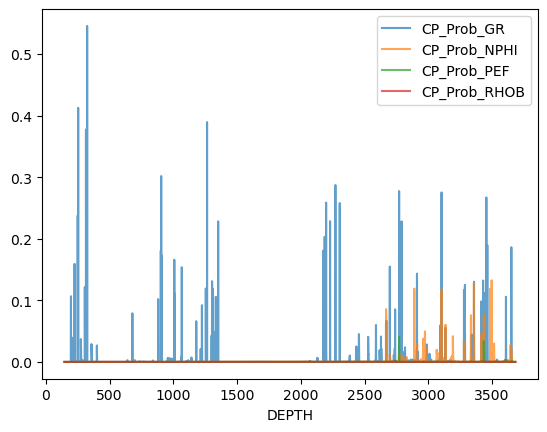

In [55]:
'''This Cell is built to check for completeness by graphing'''

cp_list = [ 'CP_Prob_GR', 'CP_Prob_NPHI', 'CP_Prob_PEF', 'CP_Prob_RHOB']
cp_GR = ['CP_Prob_GR', 'GR']

#df_f1A[cp_GR].plot(alpha=0.8)


df_f1A[cp_list].plot(alpha=0.7)
#df_f1C.plot()


In [ ]:
### Build benchmarker for sequence length here 

GR finding changepoints
None None None None None


<Axes: xlabel='DEPTH'>

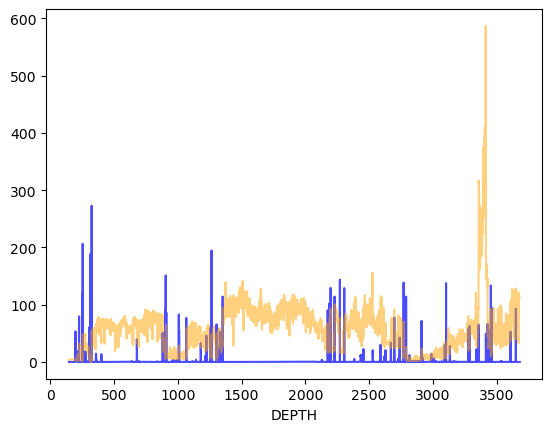

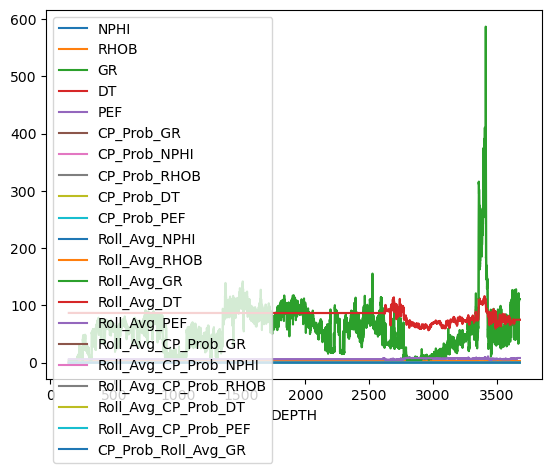

In [ ]:
cp_list = ['CP_Prob_DT', 'CP_Prob_GR', 'CP_Prob_NPHI', 'CP_Prob_PEF', 'CP_Prob_RHOB', 'CP_Prob_all']
cp_listshrt = ['CP_Prob_GR', 'GR']
#df_f11A.plot()
#df_f11A[cp_list].plot()
#stack_list = []
#for log in _log_list:
#    
#    log = df_f11A[log].to_numpy()
#
#    stack_list.append(log)
#
#f11A_all = df_f11A[_log_list].to_numpy()

#plt.plot(f11A_all)

#df_f11A['CP_Prob_RHOB'] = cp_Tools.bayes_offline_split(df_f11A['RHOB'].to_numpy(), sequence_length=1000)
plt.plot(df_f1A['CP_Prob_GR']*500, alpha=0.7, color='blue')
df_f1A['GR'].plot(alpha=0.5, color='orange');
#data_f1A.plot()
#df_f11A['CP_Prob_all'].plot()

GR finding changepoints
None None None None None
completed segment 1 from0: 100 of 35361
None None None None None
completed segment 2 from100: 200 of 35361
None None None None None
completed segment 3 from200: 300 of 35361
None None None None None
completed segment 4 from300: 400 of 35361
None None None None None
completed segment 5 from400: 500 of 35361
None None None None None
completed segment 6 from500: 600 of 35361
None None None None None
completed segment 7 from600: 700 of 35361
None None None None None
completed segment 8 from700: 800 of 35361
None None None None None
completed segment 9 from800: 900 of 35361
None None None None None
completed segment 10 from900: 1000 of 35361
None None None None None
completed segment 11 from1000: 1100 of 35361
None None None None None
completed segment 12 from1100: 1200 of 35361
None None None None None
completed segment 13 from1200: 1300 of 35361
None None None None None
completed segment 14 from1300: 1400 of 35361
None None None None None
c

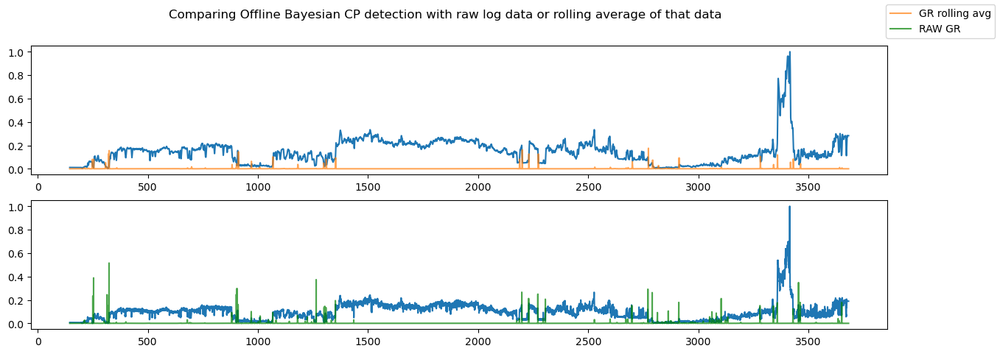

In [65]:
''' This Shows that performing the change point analysis on a log and a rolling average of the log produce comparable results, if not slightly muted for the Avg.'''
data_f1A = wtool.compute_all_rolling_avg(df_f1A, window=30, periods=3)

df_CP_Prob(data_f1A, log_dict=['GR', 'Roll_Avg_GR' ], label='CP_Prob_', method='local_average', window_size=200, sequence_length=100)

fig, ax = plt.subplots(2, figsize=(15,5))
ax[0].plot(data_f1A['Roll_Avg_GR']/data_f1A['Roll_Avg_GR'].max())
ax[0].plot(data_f1A['CP_Prob_Roll_Avg_GR'], label='GR rolling avg', alpha=0.7)

ax[1].plot(data_f1A['GR']/data_f1A['GR'].max())
ax[1].plot(data_f1A['CP_Prob_GR'], label='RAW GR', color='green', alpha=0.7)
fig.suptitle('Comparing Offline Bayesian CP detection with raw log data or rolling average of that data')
fig.legend();


#### Finding breakpoints and trends for Volve input, ONLY UNIVARIATE LOGS for this example:
Changepoints are identified by SciPy find_peaks on offline bayesian changepoint probability curve created with sdt-python (implementation of Fearnhead 2006) 
Trend values are the mean for the data sections between breakpoints. (will soon include a more complete comparitor vector [CP, AvgL, AvgR, \sigma L, \sigma R, \alpha \beta \sigma L, \alpha \beta \sigma R])


In [68]:
_log_choice = 'GR'
_prob_choice = 'CP_Prob_GR'


#prob_piecewise_linearRegress(data, prob)
f1A_GRmu, f1A_GRbp = cp_Comp.prob_piecewise_linearRegress(df_f1A[_log_choice][_logname_extent_min['f1A']:_logname_extent_max['f1A']].to_numpy(), 
                                                          df_f1A[_prob_choice][_logname_extent_min['f1A']:_logname_extent_max['f1A']].to_numpy())

f1B_GRmu, f1B_GRbp = cp_Comp.prob_piecewise_linearRegress(df_f1B[_log_choice][_logname_extent_min['f1B']:_logname_extent_max['f1B']].to_numpy(), 
                                                          df_f1B[_prob_choice][_logname_extent_min['f1B']:_logname_extent_max['f1B']].to_numpy())

f1C_GRmu, f1C_GRbp = cp_Comp.prob_piecewise_linearRegress(df_f1C[_log_choice][_logname_extent_min['f1C']:_logname_extent_max['f1C']].to_numpy(), 
                                                          df_f1C[_prob_choice][_logname_extent_min['f1C']:_logname_extent_max['f1C']].to_numpy())

f11A_GRmu, f11A_GRbp = cp_Comp.prob_piecewise_linearRegress(df_f11A[_log_choice][_logname_extent_min['f11A']:_logname_extent_max['f11A']].to_numpy(), 
                                                          df_f11A[_prob_choice][_logname_extent_min['f11A']:_logname_extent_max['f11A']].to_numpy())
                                                          
f11B_GRmu, f11B_GRbp = cp_Comp.prob_piecewise_linearRegress(df_f11B[_log_choice][_logname_extent_min['f11B']:_logname_extent_max['f11B']].to_numpy(), 
                                                          df_f11B[_prob_choice][_logname_extent_min['f11B']:_logname_extent_max['f11B']].to_numpy())

43 [   0.   85.  107.  508.  778. 1093. 1164. 1194. 1506. 1702. 1934. 1939.
 1969. 1975. 1978. 1981. 2897. 2908. 2987. 3670. 3673. 3682. 3686. 3692.
 3695. 3698. 3880. 3883. 3887. 4731. 4743. 4836. 5134. 5137. 6594. 6668.
 7202. 7380. 7959. 8092. 8153. 8347. 8423.]
[  0.          49.32954235  45.01255909  32.98968005  49.15894926
  30.97130191  36.19962394  36.18174334  38.85184327  14.06257449
   4.27076595   3.95386      5.89710333   3.49111667   3.72466667
   3.03486667   4.02948373   5.69916364  12.06255949   8.04968126
   7.86829999   8.58447778   8.54167499  10.37321665  10.39073334
   9.62563334  10.30323956  10.39503332  10.9284      13.06953436
   9.0791       8.8666172   24.63784027  29.57743329  38.49485601
  25.88917703  61.69935168  53.64663595 275.86466994 151.39252634
  58.21029347  40.6456433   19.59769211]
10 [   0.    8.  680. 1018. 1381. 1555. 1642. 1684. 1884. 1943.]
[  0.          20.70611249  46.07160119 230.3883494  120.52530469
  34.06010805  50.41796322  10.350

In [69]:
_log_choice = 'RHOB'
_prob_choice = 'CP_Prob_RHOB'


#prob_piecewise_linearRegress(data, prob)
f1A_RHOBmu, f1A_RHOBbp = cp_Comp.prob_piecewise_linearRegress(df_f1A[_log_choice][_logname_extent_min['f1A']:_logname_extent_max['f1A']].to_numpy(), 
                                                              df_f1A[_prob_choice][_logname_extent_min['f1A']:_logname_extent_max['f1A']].to_numpy())
f1B_RHOBmu, f1B_RHOBbp = cp_Comp.prob_piecewise_linearRegress(df_f1B[_log_choice][_logname_extent_min['f1B']:_logname_extent_max['f1B']].to_numpy(), 
                                                              df_f1B[_prob_choice][_logname_extent_min['f1B']:_logname_extent_max['f1B']].to_numpy())
f1C_RHOBmu, f1C_RHOBbp = cp_Comp.prob_piecewise_linearRegress(df_f1C[_log_choice][_logname_extent_min['f1C']:_logname_extent_max['f1C']].to_numpy(), 
                                                              df_f1C[_prob_choice][_logname_extent_min['f1C']:_logname_extent_max['f1C']].to_numpy())
f11A_RHOBmu, f11A_RHOBbp = cp_Comp.prob_piecewise_linearRegress(df_f11A[_log_choice][_logname_extent_min['f11A']:_logname_extent_max['f11A']].to_numpy(), 
                                                              df_f11A[_prob_choice][_logname_extent_min['f11A']:_logname_extent_max['f11A']].to_numpy())
f11B_RHOBmu, f11B_RHOBbp = cp_Comp.prob_piecewise_linearRegress(df_f11B[_log_choice][_logname_extent_min['f11B']:_logname_extent_max['f11B']].to_numpy(), 
                                                              df_f11B[_prob_choice][_logname_extent_min['f11B']:_logname_extent_max['f11B']].to_numpy())

1 [0.]
[0.]
1 [0.]
[0.]
1 [0.]
[0.]
1 [0.]
[0.]
1 [0.]
[0.]


In [70]:
_log_choice = 'PEF'
_prob_choice = 'CP_Prob_PEF'


#prob_piecewise_linearRegress(data, prob)
f1A_PEFmu, f1A_PEFbp = cp_Comp.prob_piecewise_linearRegress(df_f1A[_log_choice][_logname_extent_min['f1A']:_logname_extent_max['f1A']].to_numpy(), 
                                                            df_f1A[_prob_choice][_logname_extent_min['f1A']:_logname_extent_max['f1A']].to_numpy())
f1B_PEFmu, f1B_PEFbp = cp_Comp.prob_piecewise_linearRegress(df_f1B[_log_choice][_logname_extent_min['f1B']:_logname_extent_max['f1B']].to_numpy(), 
                                                            df_f1B[_prob_choice][_logname_extent_min['f1B']:_logname_extent_max['f1B']].to_numpy())
f1C_PEFmu, f1C_PEFbp = cp_Comp.prob_piecewise_linearRegress(df_f1C[_log_choice][_logname_extent_min['f1C']:_logname_extent_max['f1C']].to_numpy(), 
                                                            df_f1C[_prob_choice][_logname_extent_min['f1C']:_logname_extent_max['f1C']].to_numpy())
f11A_PEFmu, f11A_PEFbp = cp_Comp.prob_piecewise_linearRegress(df_f11A[_log_choice][_logname_extent_min['f11A']:_logname_extent_max['f11A']].to_numpy(), 
                                                            df_f11A[_prob_choice][_logname_extent_min['f11A']:_logname_extent_max['f11A']].to_numpy())
f11B_PEFmu, f11B_PEFbp = cp_Comp.prob_piecewise_linearRegress(df_f11B[_log_choice][_logname_extent_min['f11B']:_logname_extent_max['f11B']].to_numpy(), 
                                                            df_f11B[_prob_choice][_logname_extent_min['f11B']:_logname_extent_max['f11B']].to_numpy())

3 [   0. 1502. 8148.]
[0.         5.08135919 7.48158528]
1 [0.]
[0.]
3 [   0. 6583. 9017.]
[0.         6.08245993 5.36980924]
4 [   0.  239.  246. 9953.]
[0.         6.27603766 5.42814286 7.58307356]
13 [    0.  2492.  2672.  2695.  6092.  6537.  6551.  6951.  6969.  6979.
  7345.  7515. 12354.]
[0.         6.95702408 8.64663889 6.0946087  4.85783544 9.50748539
 8.00857143 6.95145    5.36361111 5.4746     4.42294809 6.88874706
 5.06223869]


In [75]:
_log_choice = 'NPHI'
_prob_choice = 'CP_Prob_NPHI'


#prob_piecewise_linearRegress(data, prob)
f1A_NPHImu, f1A_NPHIbp = cp_Comp.prob_piecewise_linearRegress(df_f1A[_log_choice][_logname_extent_min['f1A']:_logname_extent_max['f1A']].to_numpy(),
                                                              df_f1A[_prob_choice][_logname_extent_min['f1A']:_logname_extent_max['f1A']].to_numpy())
f1B_NPHImu, f1B_NPHIbp = cp_Comp.prob_piecewise_linearRegress(df_f1B[_log_choice][_logname_extent_min['f1B']:_logname_extent_max['f1B']].to_numpy(),
                                                              df_f1B[_prob_choice][_logname_extent_min['f1B']:_logname_extent_max['f1B']].to_numpy())
f1C_NPHImu, f1C_NPHIbp = cp_Comp.prob_piecewise_linearRegress(df_f1C[_log_choice][_logname_extent_min['f1C']:_logname_extent_max['f1C']].to_numpy(),
                                                              df_f1C[_prob_choice][_logname_extent_min['f1C']:_logname_extent_max['f1C']].to_numpy())
f11A_NPHImu, f11A_NPHIbp = cp_Comp.prob_piecewise_linearRegress(df_f11A[_log_choice][_logname_extent_min['f11A']:_logname_extent_max['f11A']].to_numpy(),
                                                              df_f11A[_prob_choice][_logname_extent_min['f11A']:_logname_extent_max['f11A']].to_numpy())
f11B_NPHImu, f11B_NPHIbp = cp_Comp.prob_piecewise_linearRegress(df_f11B[_log_choice][_logname_extent_min['f11B']:_logname_extent_max['f11B']].to_numpy(),
                                                              df_f11B[_prob_choice][_logname_extent_min['f11B']:_logname_extent_max['f11B']].to_numpy())

42 [   0.  477.  487.  499.  775. 1525. 1529. 1531. 1536. 1641. 2696. 2894.
 2903. 2918. 3391. 3534. 3551. 3566. 3669. 4450. 4461. 4468. 4470. 4478.
 4495. 4696. 4835. 5147. 5684. 5724. 5735. 6590. 6667. 7141. 7375. 7959.
 8149. 8645. 8703. 8764. 8945. 8953.]
[0.         0.24293962 0.05338    0.20248333 0.30045399 0.2502544
 0.211925   0.20805    0.20636    0.19572762 0.11803147 0.04972323
 0.05603333 0.05705333 0.06777738 0.04434126 0.06307059 0.06569333
 0.08731262 0.11569091 0.0797     0.07611429 0.0814     0.0814375
 0.07560588 0.06538607 0.05078561 0.09118077 0.12258547 0.06988
 0.1178     0.14480094 0.09105455 0.1590097  0.20671325 0.44776712
 0.33034895 0.19469536 0.09246207 0.20232131 0.09586243 0.10905   ]
13 [   0.   10.  418.  426.  681.  998. 2038. 2243. 2252. 2264. 2589. 2602.
 2621.]
[0.         0.07547    0.15274755 0.1253625  0.17507686 0.44520694
 0.22496471 0.09959512 0.11607778 0.130525   0.14858154 0.15120769
 0.16062105]
29 [   0.  424.  552. 1053. 1123. 1241. 1290

In [73]:
_log_choice = 'DT'
_prob_choice = 'CP_Prob_DT'


#prob_piecewise_linearRegress(data, prob)
f1A_DTmu, f1A_DTbp = cp_Comp.prob_piecewise_linearRegress(df_f1A[_log_choice][_logname_extent_min['f1A']:_logname_extent_max['f1A']].to_numpy(),
                                                          df_f1A[_prob_choice][_logname_extent_min['f1A']:_logname_extent_max['f1A']].to_numpy())
f1B_DTmu, f1B_DTbp = cp_Comp.prob_piecewise_linearRegress(df_f1B[_log_choice][_logname_extent_min['f1B']:_logname_extent_max['f1B']].to_numpy(),
                                                          df_f1B[_prob_choice][_logname_extent_min['f1B']:_logname_extent_max['f1B']].to_numpy())
#f1C_DTmu, f1C_DTbp = cp_Comp.prob_piecewise_linearRegress(df_f1C[_log_choice][_logname_extent_min['f1C']:_logname_extent_max['f1C']].to_numpy(),
#                                                          df_f1C[_prob_choice][_logname_extent_min['f1C']:_logname_extent_max['f1C']].to_numpy())
f11A_DTmu, f11A_DTbp = cp_Comp.prob_piecewise_linearRegress(df_f11A[_log_choice][_logname_extent_min['f11A']:_logname_extent_max['f11A']].to_numpy(),
                                                          df_f11A[_prob_choice][_logname_extent_min['f11A']:_logname_extent_max['f11A']].to_numpy())
#f11B_DTmu, f11B_DTbp = cp_Comp.prob_piecewise_linearRegress(df_f11B[_log_choice][_logname_extent_min['f11B']:_logname_extent_max['f11B']].to_numpy(),
#                                                          df_f11B[_prob_choice][_logname_extent_min['f11B']:_logname_extent_max['f11B']].to_numpy())


1 [0.]
[0.]
1 [0.]
[0.]
2 [   0. 9253.]
[ 0.         74.62065071]


#### Looking at segments bound by changepoints nad finding the trends. (Arithmetic average in this example)

In [25]:
# _log_choice = 'GR'
# _prob_choice = 'CP_Prob_GR'


# #prob_piecewise_linearRegress(data, prob)
# f1A_GRmu, f1A_GRbp = cp_Comp.prob_piecewise_linearRegress(df_f1A[_log_choice][_logname_extent_min['f1A']:_logname_extent_max['f1A']].to_numpy(), df_f1A[_prob_choice][_logname_extent_min['f1A']:_loganme_extent_max['f1A']].to_numpy())
# f1B_GRmu, f1B_GRbp = cp_Comp.prob_piecewise_linearRegress(df_f1B[_log_choice][_logname_extent_min['f1B']:_logname_extent_max['f1B']].to_numpy(), df_f1B[_prob_choice][_logname_extent_min['f1B']:_logname_extent_max['f1B']].to_numpy())
# f1C_GRmu, f1C_GRbp = cp_Comp.prob_piecewise_linearRegress(df_f1C[_log_choice][_logname_extent_min['f1C']:_logname_extent_max['f1C']].to_numpy(), df_f1C[_prob_choice][_logname_extent_min['f1C']:_logname_extent_max['f1C']].to_numpy())
# f11A_GRmu, f11A_GRbp = cp_Comp.prob_piecewise_linearRegress(df_f11A[_log_choice][_logname_extent_min['f11A']:_logname_extent_max['f11A']].to_numpy(), df_f11A[_prob_choice][_logname_extent_min['f11A']:_logname_extent_max['f11A']].to_numpy())
# f11B_GRmu, f11B_GRbp = cp_Comp.prob_piecewise_linearRegress(df_f11B[_log_choice][_logname_extent_min['f11B']:_logname_extent_max['f11B']].to_numpy(), df_f11B[_prob_choice][_logname_extent_min['f11B']:_logname_extent_max['f11B']].to_numpy())

38 [0.000e+00 7.000e+00 8.500e+01 5.080e+02 7.790e+02 1.093e+03 1.164e+03
 1.194e+03 1.506e+03 1.702e+03 1.748e+03 2.896e+03 2.908e+03 3.686e+03
 3.816e+03 3.819e+03 3.825e+03 3.828e+03 3.830e+03 3.833e+03 3.835e+03
 4.731e+03 4.742e+03 4.744e+03 4.836e+03 5.134e+03 5.137e+03 5.724e+03
 5.745e+03 6.594e+03 6.669e+03 7.380e+03 7.736e+03 7.959e+03 8.092e+03
 8.153e+03 8.347e+03 8.423e+03]
[  0.          54.64961429  48.8521      33.61498345  49.11809963
  30.94863503  36.19962394  36.18174334  38.85184327  14.06257449
   7.8243087    3.96702779   5.69643333   8.46517532   9.98192154
  10.02086665  10.28676667  10.35663331  10.66025001  10.32253334
  10.10334999  12.95766295   8.93233636  10.63995001   8.84792391
  24.63784027  29.57743329  30.99033152  36.11514285  43.74235877
  25.94024934  59.72831983 236.62713369 338.50396548 151.39252634
  58.21029347  40.6456433   19.59769211]


##### Spearman Correlation method for well log correlation, getting mixed results... 

good matching with bulk density but porosity is not as robust. Correlation must be done with matching dataset length,
this is a limition for this method as lateral continuity cannot be assumed.

In [23]:
f1B_spear = data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]].to_numpy()
f11A_spear = data_f11A[_log_choice][_log_extent_min[4]:_log_extent_max[4]].to_numpy()

#f1B_f11A_offset = spearman_offset(f1B_spear, f11A_spear, window= 700)
#f1B_RHOBbp, f1A_RHOBbp

statArgmax= 9264 val 0.8626180589046183
pvalArgmin= 9264 val 3.2379749826795956e-213
statArgmax= 6159 val 0.5697389537193023
pvalArgmin= 5363 val 0.0


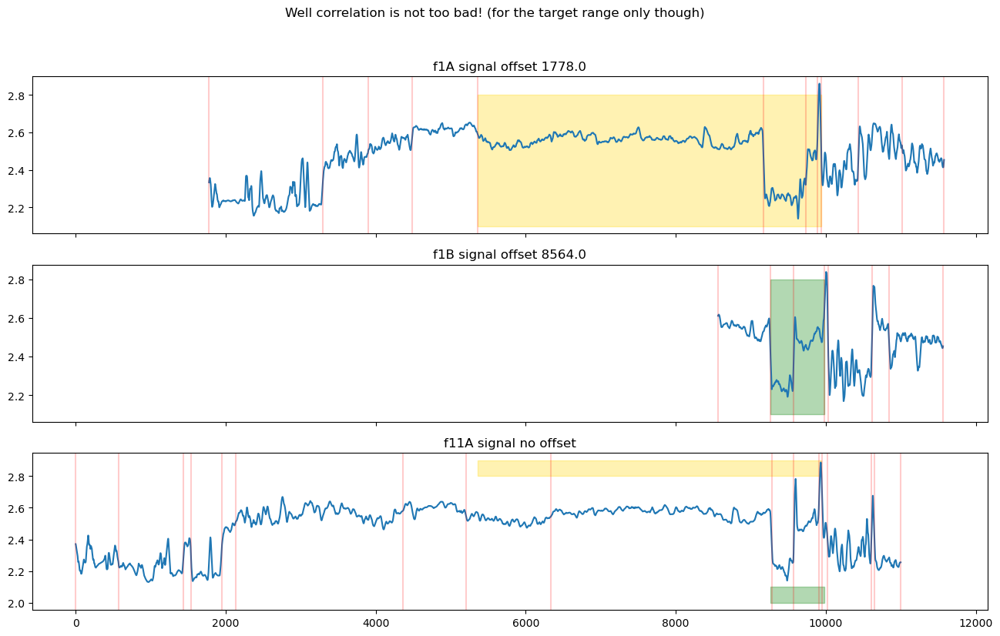

In [67]:
_log_choice = 'Roll_Avg_RHOB'
f1B_spear = data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]].to_numpy()
f11A_spear = data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]].to_numpy()
f1A_spear = data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]].to_numpy()

f1B_11A_params = {'min':1, 'max':3} 
f1A_11A_params = {'min':4, 'max':8} 



f1B_f11A_offset = spearman_offset(f1B_spear[int(f1B_RHOBbp[f1B_11A_params['min']]):int(f1B_RHOBbp[f1B_11A_params['max']])], f11A_spear, 
                                    window=len(f1B_spear[int(f1B_RHOBbp[f1B_11A_params['min']]):int(f1B_RHOBbp[f1B_11A_params['max']])]))
f1A_f11A_offset = spearman_offset(f1A_spear[int(f1A_RHOBbp[f1A_11A_params['min']]):int(f1A_RHOBbp[f1A_11A_params['max']])], f11A_spear, 
                                    window=len(f1A_spear[int(f1A_RHOBbp[f1A_11A_params['min']]):int(f1A_RHOBbp[f1A_11A_params['max']])]))

fig, ax = plt.subplots(3, figsize=[16, 9], sharex=True)
fig.suptitle('Well correlation is not too bad! (for the target range only though)')
xoffset_f11A = f1A_f11A_offset#-f1A_RHOBbp[f1A_11A_params['min']]
xoffset_f1B = f1B_f11A_offset

rangef11A = xoffset_f11A + f1A_RHOBbp[f1A_11A_params['max']] - f1A_RHOBbp[f1A_11A_params['min']]
rangef1B = xoffset_f1B + f1B_RHOBbp[f1B_11A_params['max']] - f1B_RHOBbp[f1B_11A_params['min']]

ax[0].plot(np.arange(len(f1A_spear))+f1A_f11A_offset-f1A_RHOBbp[f1A_11A_params['min']], f1A_spear)
ax[0].set_title('f1A signal offset '+str(f1A_f11A_offset-f1A_RHOBbp[f1A_11A_params['min']]))
for i in f1A_RHOBbp:
    ax[0].axvline(i+f1A_f11A_offset-f1A_RHOBbp[f1A_11A_params['min']], c='r', alpha=0.2)
A1xx = np.linspace(xoffset_f11A, rangef11A ,100)

ax[0].fill_between(A1xx, 2.8 , 2.1, alpha=0.3, color='gold')
#plt.fill_between(x, slope0 * x + intercept0, 0, facecolor='gold', alpha=0.4, edgecolor='r', hatch='xx')

B1xx = np.linspace(xoffset_f1B, rangef1B , 100)
ax[1].fill_between(B1xx, 2.8 , 2.1, alpha=0.3, color='green')
ax[1].plot(np.arange(len(f1B_spear))+f1B_f11A_offset-f1B_RHOBbp[f1B_11A_params['min']], f1B_spear)
ax[1].set_title('f1B signal offset '+ str(f1B_f11A_offset-f1B_RHOBbp[f1B_11A_params['min']]))
for i in f1B_RHOBbp:
    ax[1].axvline(i+f1B_f11A_offset-f1B_RHOBbp[f1B_11A_params['min']], c='r', alpha=0.2)

ax[2].fill_between(A1xx, 2.9 , 2.8, alpha=0.3, color='gold')
ax[2].fill_between(B1xx, 2.0 , 2.1, alpha=0.3, color='green')
ax[2].plot(np.arange(len(f11A_spear)), f11A_spear)
ax[2].set_title('f11A signal no offset')
for i in f11A_RHOBbp:
    ax[2].axvline(i, c='r', alpha=0.2)

statArgmax= 9177 val 0.8719083228391188
pvalArgmin= 9177 val 7.572645184429486e-270
statArgmax= 7116 val 0.774106628017517
pvalArgmin= 7116 val 7.414441493826371e-118


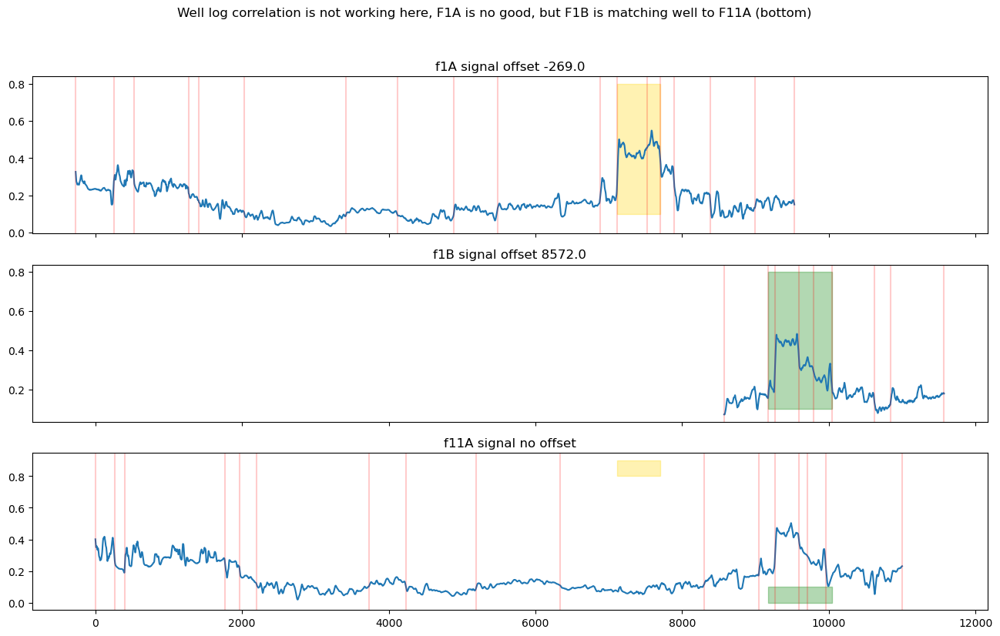

In [69]:
_log_choice = 'Roll_Avg_NPHI'
f1B_spear = data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]].to_numpy()
f11A_spear = data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]].to_numpy()
f1A_spear = data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]].to_numpy()

f1B_11A_params = {'min':1, 'max':5} 
f1A_11A_params = {'min':11, 'max':13} 



f1B_f11A_offset = spearman_offset(f1B_spear[int(f1B_NPHIbp[f1B_11A_params['min']]):int(f1B_NPHIbp[f1B_11A_params['max']])], f11A_spear, 
                                    window=len(f1B_spear[int(f1B_NPHIbp[f1B_11A_params['min']]):int(f1B_NPHIbp[f1B_11A_params['max']])]))
f1A_f11A_offset = spearman_offset(f1A_spear[int(f1A_NPHIbp[f1A_11A_params['min']]):int(f1A_NPHIbp[f1A_11A_params['max']])], f11A_spear, 
                                    window=len(f1A_spear[int(f1A_NPHIbp[f1A_11A_params['min']]):int(f1A_NPHIbp[f1A_11A_params['max']])]), param='sval')

fig, ax = plt.subplots(3, figsize=[16, 9], sharex=True)
fig.suptitle('Well log correlation is not working here, F1A is no good, but F1B is matching well to F11A (bottom)')
xoffset_f11A = f1A_f11A_offset#-f1A_NPHIbp[f1A_11A_params['min']]
xoffset_f1B = f1B_f11A_offset

#rangef11A = yoffset_f11A + f1A_NPHIbp[f1A_11A_params['max']] - f1A_NPHIbp[f1A_11A_params['min']]
#rangef1B = xoffset_f1B + f1B_NPHIbp[f1B_11A_params['max']] - f1B_NPHIbp[f1B_11A_params['min']]

rangef11A = xoffset_f11A + f1A_NPHIbp[f1A_11A_params['max']] - f1A_NPHIbp[f1A_11A_params['min']]
rangef1B = xoffset_f1B + f1B_NPHIbp[f1B_11A_params['max']] - f1B_NPHIbp[f1B_11A_params['min']]

ax[0].plot(np.arange(len(f1A_spear))+f1A_f11A_offset-f1A_NPHIbp[f1A_11A_params['min']], f1A_spear)
ax[0].set_title('f1A signal offset '+str(f1A_f11A_offset-f1A_NPHIbp[f1A_11A_params['min']]))
for i in f1A_NPHIbp:
    ax[0].axvline(i+f1A_f11A_offset-f1A_NPHIbp[f1A_11A_params['min']], c='r', alpha=0.2)
A1xx = np.linspace(xoffset_f11A, rangef11A ,100)

ax[0].fill_between(A1xx, .8 , .1, alpha=0.3, color='gold')
#plt.fill_between(x, slope0 * x + intercept0, 0, facecolor='gold', alpha=0.4, edgecolor='r', hatch='xx')

B1xx = np.linspace(xoffset_f1B, rangef1B , 100)
ax[1].fill_between(B1xx, .8 , .1, alpha=0.3, color='green')
ax[1].plot(np.arange(len(f1B_spear))+f1B_f11A_offset-f1B_NPHIbp[f1B_11A_params['min']], f1B_spear)
ax[1].set_title('f1B signal offset '+ str(f1B_f11A_offset-f1B_NPHIbp[f1B_11A_params['min']]))
for i in f1B_NPHIbp:
    ax[1].axvline(i+f1B_f11A_offset-f1B_NPHIbp[f1B_11A_params['min']], c='r', alpha=0.2)

ax[2].fill_between(A1xx, .9 , .8, alpha=0.3, color='gold')
ax[2].fill_between(B1xx, .0 , .1, alpha=0.3, color='green')
ax[2].plot(np.arange(len(f11A_spear)), f11A_spear)
ax[2].set_title('f11A signal no offset')
for i in f11A_NPHIbp:
    ax[2].axvline(i, c='r', alpha=0.2)

#### The following section are other methods that I am working with for automated correlation

1700771.96897444


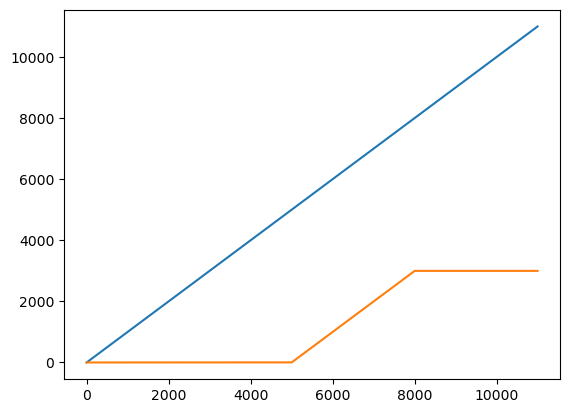

In [310]:

'''This cell is attempting some correlation with Dynamic Time Warping... I'm not getting perfect results with it but I think it
has good potenial.  

This very recent publication thinks so too:
Automated multi-well stratigraphic correlation and model building using relative geologic time
Zoltán Sylvester
First published: 16 June 2023 https://doi.org/10.1111/bre.12787
'''

#for i in f1B_RHOBbp:
import numpy as np
from scipy.spatial.distance import euclidean
#from fastdtw import fastdtw
_log_choice = 'Roll_Avg_RHOB'
#f1B_DTW = data_f1B['DEPTH',_log_choice][_log_extent_min[1]:_log_extent_max[1]].to_numpy()
#f11A_DTW = data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]].to_xarray()
#f1A_DTW = data_f1A[_log_choice][_log_extent_min[0]:_log_extent_max[0]].to_xarray()
#x = np.array([[1,1], [2,2], [3,3], [4,4], [5,5]])
#y = np.array([[2,2], [3,3], [4,4]])


y = np.column_stack((data_f1B[_log_extent_min[1]:_log_extent_max[1]].index, data_f1B[_log_choice][_log_extent_min[1]:_log_extent_max[1]]))
x = np.column_stack((data_f11A[_log_extent_min[3]:_log_extent_max[3]].index, data_f11A[_log_choice][_log_extent_min[3]:_log_extent_max[3]]))
#distance, path = fastdtw(x, y, dist=euclidean)
#print(distance)
plt.plot(path)
#
#x[:19]
#f1B_f11A_offset = spearman_offset(f1B_spear[int(f1B_RHOBbp[f1B_11A_params['min']]):int(f1B_RHOBbp[f1B_11A_params['max']])], f11A_spear, 
#                                    window=len(f1B_spear[int(f1B_RHOBbp[f1B_11A_params['min']]):int(f1B_RHOBbp[f1B_11A_params['max']])]))

In [259]:
#import fastdtw
import scipy.spatial.distance as sd

#def my_fastdtw(x, y):
#    return fastdtw.fastdtw(x,y)[0]

#distance_matrix = sd.pdist(y,my_fastdtw)

In [344]:
f1A_f11A_sets = generate_progressive_combinations(f1B_NPHIbp,f1B_NPHIbp)
#type(f1A_f11A_sets)
f1A_f11A_sets
f1A_f11A_sets = np.array(f1A_f11A_sets, dtype=int)
f1A_f11A_sets
combi = []
for i, j in enumerate(f1A_f11A_sets):
    #print(j[0],j[1])
    combi.append(spearman_offset(f1A_spear[j[0]:j[1]], f11A_spear, 
                                    window=len(f1A_spear[j[0]:j[1]])))

statArgmax= 4551 val 0.8415712070906067
pvalArgmin= 4551 val 1.952261732518175e-163
statArgmax= 4550 val 0.8131349119253737
pvalArgmin= 4550 val 5.029005451761958e-165
statArgmax= 7006 val 0.6863748795326312
pvalArgmin= 7006 val 2.794748452471423e-142
statArgmax= 8740 val 0.41506600243000674
pvalArgmin= 8740 val 5.374091392459342e-52
statArgmax= 3201 val 0.38784025556407925
pvalArgmin= 3201 val 5.809180843045754e-54
statArgmax= 448 val 0.6789751055191761
pvalArgmin= 448 val 3.589887567022892e-277
statArgmax= 426 val 0.7510428669370334
pvalArgmin= 391 val 0.0
statArgmax= 421 val 0.8603642041360631
pvalArgmin= 0 val 0.0
statArgmax= 7207 val 0.8324237560192616
pvalArgmin= 10347 val 1.1372522963480483e-27
statArgmax= 8560 val 0.7980742184592441
pvalArgmin= 8560 val 8.581706696777233e-92
statArgmax= 9768 val 0.6522811620730109
pvalArgmin= 594 val 2.343602161070223e-93
statArgmax= 9766 val 0.5974035162664032
pvalArgmin= 9766 val 8.5398795595591e-85
statArgmax= 5924 val 0.808223988946808
pval

In [348]:
#combi, 
f1A_f11A_sets[3:5]

array([[   0, 1220],
       [   0, 1470]])

In [281]:
def dtw_offset(comparitee_vector, comparitor_vector, **kwargs):
    _window = kwargs.get('window')
    distance = []
    path = []
    tee = comparitee_vector
    tor = comparitor_vector
    iter = len(tor)-len(tee)
    if len(tor)<len(tee[:_window]):
        print("Comparitor is shorter than comparitee, this won't do, try a shorter sequence") 
    else:
        for i in range(iter):
            _distance, _path = fastdtw(tor[i:i+_window],tee[:_window], dist=euclidean)
            distance.append(_distance)
            path.append(_path)
        distanceAray = np.array(distance)
        #statAray = np.nan_to_num(statAray, nan=0.0)
        
        #pathAray = np.array(path)#.reshape(_window,iter)
        #pvalueAray = np.nan_to_num(pvalueAray, nan=1)
        #print('statArgmax= ' + str(statAray.argmax()) + ' val ' + str(statAray[statAray.argmax()]))
        #print('pvalArgmin= ' + str(pvalueAray.argmin()) + ' val ' + str(pvalueAray[pvalueAray.argmin()]))
        #print
    return distanceAray, path

In [282]:
# dist, path = dtw_offset(y,x, window=1000) # <- BE CAREFUL THIS IS VERY INEFFICIENT (27m 7sec)

#print(dist, path)
#patharay = np.array(path[0])
#dist, path

(array([500000.05758814, 499900.05768573, 499800.05778269, ...,
        299700.04282786, 299800.04280254, 299900.04277836]),
 [[(0, 0),
   (1, 1),
   (2, 2),
   (3, 3),
   (4, 4),
   (5, 5),
   (6, 6),
   (7, 7),
   (8, 8),
   (9, 9),
   (10, 10),
   (11, 11),
   (12, 12),
   (13, 13),
   (14, 14),
   (15, 15),
   (16, 16),
   (17, 17),
   (18, 18),
   (19, 19),
   (20, 20),
   (21, 21),
   (22, 22),
   (23, 23),
   (24, 24),
   (25, 25),
   (26, 26),
   (27, 27),
   (28, 28),
   (29, 29),
   (30, 30),
   (31, 31),
   (32, 32),
   (33, 33),
   (34, 34),
   (35, 35),
   (36, 36),
   (37, 37),
   (38, 38),
   (39, 39),
   (40, 40),
   (41, 41),
   (42, 42),
   (43, 43),
   (44, 44),
   (45, 45),
   (46, 46),
   (47, 47),
   (48, 48),
   (49, 49),
   (50, 50),
   (51, 51),
   (52, 52),
   (53, 53),
   (54, 54),
   (55, 55),
   (56, 56),
   (57, 57),
   (58, 58),
   (59, 59),
   (60, 60),
   (61, 61),
   (62, 62),
   (63, 63),
   (64, 64),
   (65, 65),
   (66, 66),
   (67, 67),
   (68, 68)

In [287]:
#len(dist), min(dist), np.argmin(dist), max(dist), np.argmax(dist)

(8000, 95.28381905947617, 5000, 500000.05758814263, 0)

In [296]:
log_win = 2500

_dist, _path = dtw_offset(y, x[:4000], window=log_win)

In [297]:
len(_dist), min(_dist), np.argmin(_dist), max(_dist), np.argmax(_dist)

(1000, 1000250.1531196595, 999, 1250000.1162176866, 0)

##### This section runs a very permissible cosine similarity inference, so there is a lot of noise in the result.

Finding a more decerning algorythm is a topic of research on it's own but for this example it illustrates the point.
 

In [76]:
# Stacking breakpoint/trends from seach function for input into the correlation function.

cpf1A_RHOB = np.vstack((f1A_RHOBbp, f1A_RHOBmu))
cpf1B_RHOB = np.vstack((f1B_RHOBbp, f1B_RHOBmu))
cpf1C_RHOB = np.vstack((f1C_RHOBbp, f1C_RHOBmu))
cpf11A_RHOB = np.vstack((f11A_RHOBbp, f11A_RHOBmu))
cpf11B_RHOB = np.vstack((f11B_RHOBbp, f11B_RHOBmu))

cpf1A_PEF = np.vstack((f1A_PEFbp, f1A_PEFmu))
cpf1B_PEF = np.vstack((f1B_PEFbp, f1B_PEFmu))
cpf1C_PEF = np.vstack((f1C_PEFbp, f1C_PEFmu))
cpf11A_PEF = np.vstack((f11A_PEFbp, f11A_PEFmu))
cpf11B_PEF = np.vstack((f11B_PEFbp, f11B_PEFmu))

cpf1A_NPHI = np.vstack((f1A_NPHIbp, f1A_NPHImu))
cpf1B_NPHI = np.vstack((f1B_NPHIbp, f1B_NPHImu))
cpf1C_NPHI = np.vstack((f1C_NPHIbp, f1C_NPHImu))
cpf11A_NPHI = np.vstack((f11A_NPHIbp, f11A_NPHImu))
cpf11B_NPHI = np.vstack((f11B_NPHIbp, f11B_NPHImu))

cpf1A_GR = np.vstack((f1A_GRbp, f1A_GRmu))
cpf1B_GR = np.vstack((f1B_GRbp, f1B_GRmu))
cpf1C_GR = np.vstack((f1C_GRbp, f1C_GRmu))
cpf11A_GR = np.vstack((f11A_GRbp, f11A_GRmu))
cpf11B_GR = np.vstack((f11B_GRbp, f11B_GRmu))


In [78]:
operator = 'cosine'
thresh = 0.999999

#f1B_11A_PEFcorr = cp_Comp.cpCorrelation(cpf1B_PEF, cpf11A_PEF, operator=operator, thresh = thresh)
f1C_11A_PEFcorr = cp_Comp.cpCorrelation(cpf1C_PEF, cpf11A_PEF, operator=operator, thresh = thresh)
f1A_11A_PEFcorr = cp_Comp.cpCorrelation(cpf1A_PEF, cpf11A_PEF, operator=operator, thresh = thresh)
f11B_11A_PEFcorr = cp_Comp.cpCorrelation(cpf11B_PEF, cpf11A_PEF, operator=operator, thresh = thresh)

*****MATCH1.0
*****MATCH1.0
*****MATCH1.0


In [79]:
operator = 'cosine'
thresh = 0.999999

f1B_11A_NPHIcorr = cp_Comp.cpCorrelation(cpf1B_NPHI, cpf11A_NPHI, operator=operator, thresh = thresh)
f1C_11A_NPHIcorr = cp_Comp.cpCorrelation(cpf1C_NPHI, cpf11A_NPHI, operator=operator, thresh = thresh)
f1A_11A_NPHIcorr = cp_Comp.cpCorrelation(cpf1A_NPHI, cpf11A_NPHI, operator=operator, thresh = thresh)
f11B_11A_NPHIcorr = cp_Comp.cpCorrelation(cpf11B_NPHI, cpf11A_NPHI, operator=operator, thresh = thresh)

*****MATCH1.0
*****MATCH0.9999999397793932
*****MATCH0.9999999042282469
*****MATCH0.9999990808922256
*****MATCH1.0
*****MATCH0.9999996736923793
*****MATCH0.9999995494356261
*****MATCH0.9999998338983677
*****MATCH0.9999992712730218
*****MATCH0.9999993854190591
*****MATCH0.9999999282937865
*****MATCH0.9999996938535929
*****MATCH0.999999619315717
*****MATCH1.0
*****MATCH0.999999709930264
*****MATCH0.9999998778177241
*****MATCH0.9999992389960402
*****MATCH0.999999570429197
*****MATCH0.9999996330133213
*****MATCH0.9999999902263577
*****MATCH0.9999991194686089
*****MATCH0.9999999977500615
*****MATCH0.9999992889051453
*****MATCH0.9999990792083074
*****MATCH0.999999960568564
*****MATCH0.9999996647818946
*****MATCH0.9999993450436746
*****MATCH0.9999997263294124
*****MATCH0.9999999682912887
*****MATCH0.9999999883167665
*****MATCH1.0
*****MATCH0.9999991383180609
*****MATCH0.9999993116511553
*****MATCH0.9999993499613816
*****MATCH0.9999999268879188
*****MATCH0.999999978836054
*****MATCH0.999999795

In [80]:
operator = 'cosine'
thresh = 0.999999

f1B_11A_GRcorr = cp_Comp.cpCorrelation(cpf1B_GR, cpf11A_GR, operator=operator, thresh = thresh)
f1C_11A_GRcorr = cp_Comp.cpCorrelation(cpf1C_GR, cpf11A_GR, operator=operator, thresh = thresh)
f1A_11A_GRcorr = cp_Comp.cpCorrelation(cpf1A_GR, cpf11A_GR, operator=operator, thresh = thresh)
f11B_11A_GRcorr = cp_Comp.cpCorrelation(cpf11B_GR, cpf11A_GR, operator=operator, thresh = thresh)

*****MATCH1.0
*****MATCH0.9999992456426867
*****MATCH1.0
*****MATCH0.9999993065727064
*****MATCH0.9999992833466405
*****MATCH0.9999997776295727
*****MATCH0.9999999893845768
*****MATCH0.9999999707160395
*****MATCH0.9999999798914273
*****MATCH0.9999997551476444
*****MATCH0.9999998217738848
*****MATCH0.9999990015259163
*****MATCH0.9999997147907164
*****MATCH0.9999992531065975
*****MATCH1.0
*****MATCH0.9999999637108616
*****MATCH0.9999992985484908
*****MATCH0.9999990163557202
*****MATCH0.9999998848075518
*****MATCH0.999999129574814
*****MATCH0.9999999841868391
*****MATCH0.9999999956009332
*****MATCH0.9999999850689866
*****MATCH0.9999999838632164
*****MATCH0.99999901189576
*****MATCH0.9999996300218743
*****MATCH1.0
*****MATCH0.9999999736612095
*****MATCH0.9999999795478038
*****MATCH0.9999999707142866
*****MATCH0.9999999884340188
*****MATCH0.9999996787035235
*****MATCH0.9999999410533298
*****MATCH0.9999999194835979
*****MATCH0.999999980802674
*****MATCH0.9999996438979079
*****MATCH0.99999948

In [84]:
operator = 'cosine'
thresh = 0.99999999

#f1B_11A_RHOBcorr = cp_Comp.cpCorrelation(cpf1B_RHOB, cpf11A_RHOB, operator=operator, thresh = thresh)
#f1C_11A_RHOBcorr = cp_Comp.cpCorrelation(cpf1C_RHOB, cpf11A_RHOB, operator=operator, thresh = thresh)
#f1A_11A_RHOBcorr = cp_Comp.cpCorrelation(cpf1A_RHOB, cpf11A_RHOB, operator=operator, thresh = thresh)
#f11B_11A_RHOBcorr = cp_Comp.cpCorrelation(cpf11B_RHOB, cpf11A_RHOB, operator=operator, thresh = thresh)

In [88]:
f11A_corrmatrix = cp_Comp.combine_vectors_to_matrix_(f1A_11A_NPHIcorr, f1C_11A_NPHIcorr, f11B_11A_NPHIcorr , f1B_11A_NPHIcorr,
#                                                    f1B_11A_RHOBcorr,f1C_11A_RHOBcorr, f1Af1B_11A_PEFcorr,_11A_RHOBcorr, f11B_11A_RHOBcorr,
                                                    f1B_11A_GRcorr,f1C_11A_GRcorr, f1A_11A_GRcorr, f11B_11A_GRcorr,
                                                    #f1B_11A_PEFcorr,
                                                    f1C_11A_PEFcorr, f1A_11A_PEFcorr, f11B_11A_PEFcorr,)

f11A_corrmatrixNPHI = cp_Comp.combine_vectors_to_matrix_(f1A_11A_NPHIcorr, f1C_11A_NPHIcorr, f11B_11A_NPHIcorr , f1B_11A_NPHIcorr)

#f11A_corrmatrixRHOB = cp_Comp.combine_vectors_to_matrix_(f1B_11A_RHOBcorr,f1C_11A_RHOBcorr, f1A_11A_RHOBcorr, f11B_11A_RHOBcorr)

f11A_corrmatrixGR = cp_Comp.combine_vectors_to_matrix_(f1B_11A_GRcorr,f1C_11A_GRcorr, f1A_11A_GRcorr, f11B_11A_GRcorr)

f11A_corrmatrixPEF = cp_Comp.combine_vectors_to_matrix_(f1C_11A_PEFcorr, f1A_11A_PEFcorr, f11B_11A_PEFcorr) #f1B_11A_PEFcorr,

rows  21726 columns 11
rows  21636 columns 4
rows  21726 columns 4
rows  16298 columns 3


In [89]:
f11A_FM = {0:'Norland GP FM', 1:'Ty FM', 2:'Ekofisk FM', 3:'Hod FM', 4:'Draupne FM', 5:'Heather FM', 6:'Heather FM (Sand)', 7:'Hugin FM', 8:'Sleipner FM'}
f11A_color = {0:'r', 1:'g', 2:'purple', 3:'orange', 4:'yellow', 5:'grey', 6:'black', 7:'pink', 8:'blue'}
f11A_tops = np.array([2600, 2624,2794.5,3118,3525.8,3574.9,3585.2,3594.6,3702])

vectors = []

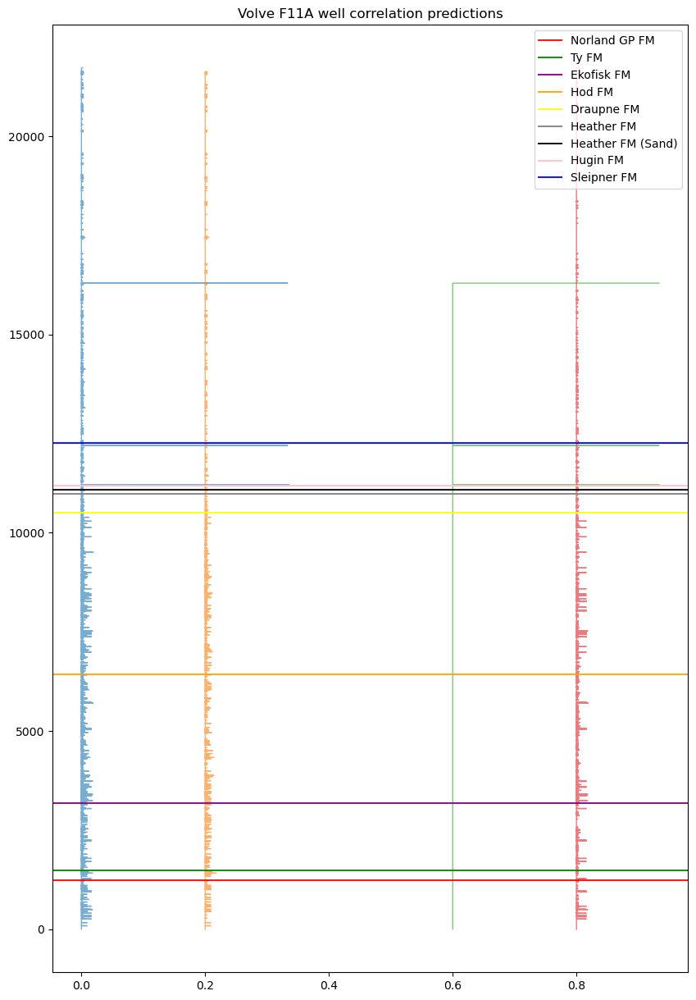

In [94]:
import matplotlib as mpl
#cmap = mpl.colormaps['']
plt.figure(figsize=(10,15))
plt.plot(np.sum(f11A_corrmatrix, axis=1), np.arange(len(f11A_corrmatrix)), linewidth=1, alpha=.6 )
plt.plot(np.sum(f11A_corrmatrixNPHI, axis=1)+0.2, np.arange(len(f11A_corrmatrixNPHI)), linewidth=1, alpha=.6 )
#plt.plot(np.sum(f11A_corrmatrixRHOB, axis=1)+0.4, np.arange(len(f11A_corrmatrixRHOB)), linewidth=1, alpha=.6 )
plt.plot(np.sum(f11A_corrmatrixPEF, axis=1)+0.6, np.arange(len(f11A_corrmatrixPEF)), linewidth=1, alpha=.6 )
plt.plot(np.sum(f11A_corrmatrixGR, axis=1)+0.8, np.arange(len(f11A_corrmatrixGR)), linewidth=1, alpha=.6 )
maxx = len(df_f11A)
f11A_top10 = f11A_tops*10-24760 #25400
plt.title('Volve F11A well correlation predictions')
#f11A_top10
#cmap = plt.colormaps('turbo')
k=0
for i in f11A_top10:
    plt.axhline(i, alpha=0.9, color=f11A_color[k], label=f11A_FM[k])
    #print(k)
    k=k+1
plt.legend(loc='upper right')

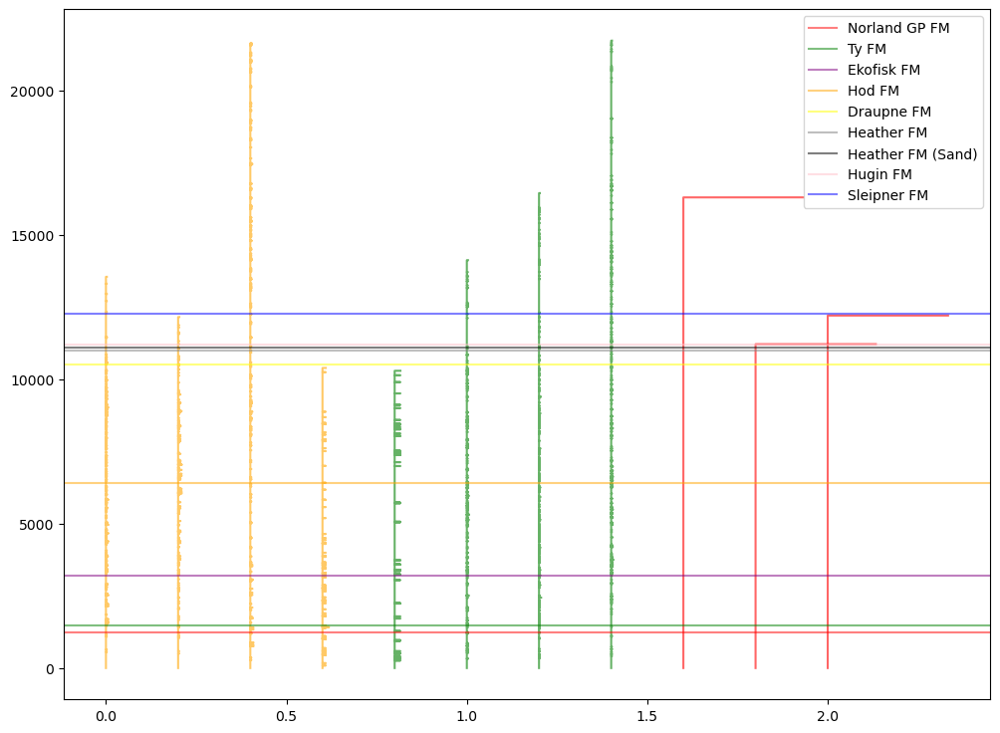

In [96]:
corrs = [f1A_11A_NPHIcorr, f1C_11A_NPHIcorr, f11B_11A_NPHIcorr , f1B_11A_NPHIcorr,
#            f1B_11A_RHOBcorr,f1C_11A_RHOBcorr, f1A_11A_RHOBcorr, f11B_11A_RHOBcorr,
            f1B_11A_GRcorr,f1C_11A_GRcorr, f1A_11A_GRcorr, f11B_11A_GRcorr,
            f1C_11A_PEFcorr, f1A_11A_PEFcorr, f11B_11A_PEFcorr] #f1B_11A_PEFcorr,
colory = {0:'orange', 1: 'orange', 2: 'orange', 3: 'orange', 4: 'green', 5: 'green', 6: 'green', 7: 'green', 8:'red',9:'red', 10:'red', 11: 'red', 12: 'purple', 13:'purple',14:'purple',15:'purple' }
plt.figure(figsize=(12,9))
for i in range(len(corrs)):
    plt.plot(corrs[i]+i*0.2, np.arange(len(corrs[i])), color=colory[i], alpha=0.6)
f11A_top10 = f11A_tops*10-24760
#f11A_top10
#cmap = plt.colormaps('turbo')
k=0
for i in f11A_top10:
    plt.axhline(i, alpha=0.5, color=f11A_color[k], label=f11A_FM[k])
    #print(k)
    k=k+1
plt.legend(loc='upper right')

In [137]:
def prob_cpCorrelation(cpComparitee, cpComparitor, **kwargs):
    
    '''Correlation engine for changepoint associations:
    takes in two vectors (m x n) of changepoints/trends. One compariTEE who is compared to the compariTOR.
    
    Relative changepoint (vector[0]) and corresponding trend values (vector[1:]) 
    
    
    Uses a kwarg to choose the geometric comparitor operation:
    
    operator= 
    'cosine'
    'euclidean'
    'theta'
    'triangle'
    'sector'
    'mag'


    Builds output of change points that correspond to all remaining changepoints after the matching input vector. 
    '''

    #for key, value in kwargs.items():
        #print(f"{key}: {value}")

    tee = cpCompConstructor(cpComparitee)
    tor = cpCompConstructor(cpComparitor)
    
    opFunc_dict = {'cosine':Cosine, 'euclidean': Euclidean, 'theta': Theta, 'triangle': Triangle, 'sector': Sector, 'magnitude': Magnitude_Difference} 
    _operator = kwargs.get('operator')
    
    _threshold = kwargs.get('thresh')

    _df = kwargs.get('df')
    _log = kwargs.get('log')



    operator = opFunc_dict[_operator]

    QumeProb = np.array([])
    k = 1
    '''    
    cos_thresh = 0.999999 # match is 1.0 (very tight threshhold, all reasonalble values are very close to 1.0)
    euclidean_thresh = 0.1 # match is near zero
    theta_thresh = 0.1745 # match is .1745
    triangle_thresh = 0.2 # match is near zero
    sector_thresh = 0.1 # match is near zero
    '''
    
    for i in range(1,len(tee)):
        for j in range(1,len(tor)):
            #print('iter')
            #print(tor[j][1],tor[j][2])
            #print(tee[i][1],tee[i][2])
            #if tor[j][1] == tee[i][1] and tor[j][2] == tee[i][2]:
            if operator(tor[j][1:], tee[i][1:]) >= _threshold:
                print('*****MATCH' + str(operator(tor[j][1:], tee[i][1:])))
                probAdd = _df[_log].to_numpy()
                #print(tor[i][1],tor[i][2])
                #print(tee[j][1],tee[j][2])    
                QumeProb = add_timelines(QumeProb, probAdd, start1=0, start2=int(tor[j][0]))    
    #unique, counts = np.unique(CumulativeProb, return_counts=True)
    
    V = QumeProb 
    
    return V

def add_timelines(timeline1, timeline2, start1, start2):
    # Determine the length and ending indices of the timelines
    len1 = len(timeline1)
    len2 = len(timeline2)
    end1 = start1 + len1
    end2 = start2 + len2
    
    # Determine the length of the combined timeline
    combined_length = max(end1, end2)
    
    # Create an empty combined timeline
    combined_timeline = np.zeros(combined_length)
    
    # Add the first timeline to the combined timeline
    combined_timeline[start1:end1] += timeline1
    
    # Add the second timeline to the combined timeline
    combined_timeline[start2:end2] += timeline2
    
    return combined_timeline


def cpCompConstructor(cpWell):
    '''Creates a ChangePoint input 'length' of Rows by 3 columns matrix 
    that will be used to compare sequentially to another changepoint matix'''
    
    cpBLNK = cpWell
    
    cpCompWellX = np.empty(3*len(cpBLNK[0])).reshape(len(cpBLNK[0]),3)
    
    #Setting special case Zero offset (Start of well) condition, to initial values
    cpCompWellX[0] = np.array((cpBLNK[0,0],cpBLNK[1,0],cpBLNK[1,0]))
    #for loop follows through with the rest of the ChangePTS
    for i in range(1,len(cpBLNK[0])):

        cpCompWellX[i] = np.array((cpBLNK[0,i],cpBLNK[1,i-1],cpBLNK[1,i]))
    return cpCompWellX #Returns matix

def Cosine(comparitee_vector, comparitor_vector):
    dot_product = np.dot(comparitee_vector, comparitor_vector.T)
    denominator = (np.linalg.norm(comparitee_vector) * np.linalg.norm(comparitor_vector))
    return dot_product/denominator

    # Euclidean Distance - Multi dimentional pythagorean eq.
def Euclidean(comparitee_vector, comparitor_vector):
    vec1 = comparitee_vector.copy()
    vec2 = comparitor_vector.copy()
    if len(vec1)<len(vec2): vec1,vec2 = vec2,vec1
    #vec2 = np.resize(vec2,(vec1.shape[0],vec1.shape[1]))
    return np.linalg.norm(vec1-vec2)

# Adaptation of Cosine similarity
def Theta(comparitee_vector, comparitor_vector):
    return np.arccos(Cosine(comparitee_vector, comparitor_vector)) + np.radians(10)

#Triangle Area Similarity – Sector Area Similarity.
# 1. Angle
# 2. Euclidean Distance between vectors
# 3. Magnitude of vectors
def Triangle(comparitee_vector, comparitor_vector):
    theta = np.radians(Theta(comparitee_vector, comparitor_vector))
    return ((np.linalg.norm(comparitee_vector) * np.linalg.norm(comparitor_vector)) * np.sin(theta))/2

#Magnitude Difference
def Magnitude_Difference(vec1, vec2):
    return abs((np.linalg.norm(vec1) - np.linalg.norm(vec2)))
    
    
#Sector Area Similarity    
def Sector(comparitee_vector, comparitor_vector):
    ED = Euclidean(comparitee_vector, comparitor_vector)
    MD = Magnitude_Difference(comparitee_vector, comparitor_vector)
    theta = Theta(comparitee_vector, comparitor_vector)
    return np.pi * (ED + MD)**2 * theta/360

In [161]:
operator = 'cosine'
thresh = 0.99999999

#f1B_11A_GRcorr = cp_Comp.cpCorrelation(cpf1B_GR, cpf11A_GR, operator=operator, thresh = thresh)
f1A_11A_GR_prob = prob_cpCorrelation(cpf1A_GR, cpf11A_GR, operator=operator, thresh = thresh, df=df_f1B, log='CP_Prob_GR')
f1C_11A_GR_prob = prob_cpCorrelation(cpf1C_GR, cpf11A_GR, operator=operator, thresh = thresh, df=df_f1B, log='CP_Prob_GR')
f1B_11A_GR_prob = prob_cpCorrelation(cpf1B_GR, cpf11A_GR, operator=operator, thresh = thresh, df=df_f1B, log='CP_Prob_GR')
f11B_11A_GR_prob = prob_cpCorrelation(cpf1B_GR, cpf11A_GR, operator=operator, thresh = thresh, df=df_f1B, log='CP_Prob_GR')

*****MATCH1.0
*****MATCH0.9999999956009332
*****MATCH1.0
*****MATCH1.0
*****MATCH1.0


In [162]:
operator = 'cosine'
thresh = 0.999999999

#f1B_11A_GRcorr = cp_Comp.cpCorrelation(cpf1B_GR, cpf11A_GR, operator=operator, thresh = thresh)
f1A_11A_NPHI_prob = prob_cpCorrelation(cpf1A_NPHI, cpf11A_NPHI, operator=operator, thresh = thresh, df=df_f1B, log='CP_Prob_GR')
f1C_11A_NPHI_prob = prob_cpCorrelation(cpf1C_NPHI, cpf11A_NPHI, operator=operator, thresh = thresh, df=df_f1B, log='CP_Prob_GR')
f1B_11A_NPHI_prob = prob_cpCorrelation(cpf1B_NPHI, cpf11A_NPHI, operator=operator, thresh = thresh, df=df_f1B, log='CP_Prob_GR')
f11B_11A_NPHI_prob = prob_cpCorrelation(cpf1B_NPHI, cpf11A_NPHI, operator=operator, thresh = thresh, df=df_f1B, log='CP_Prob_GR')

*****MATCH1.0
*****MATCH1.0
*****MATCH1.0
*****MATCH1.0


In [163]:
operator = 'cosine'
thresh = 0.999999999

#f1B_11A_GRcorr = cp_Comp.cpCorrelation(cpf1B_GR, cpf11A_GR, operator=operator, thresh = thresh)
f1A_11A_PEF_prob = prob_cpCorrelation(cpf1A_PEF, cpf11A_PEF, operator=operator, thresh = thresh, df=df_f1B, log='CP_Prob_GR')
f1C_11A_PEF_prob = prob_cpCorrelation(cpf1C_PEF, cpf11A_PEF, operator=operator, thresh = thresh, df=df_f1B, log='CP_Prob_GR')
f1B_11A_PEF_prob = prob_cpCorrelation(cpf1B_PEF, cpf11A_PEF, operator=operator, thresh = thresh, df=df_f1B, log='CP_Prob_GR')
f11B_11A_PEF_prob = prob_cpCorrelation(cpf1B_PEF, cpf11A_PEF, operator=operator, thresh = thresh, df=df_f1B, log='CP_Prob_GR')

*****MATCH1.0
*****MATCH1.0


In [164]:
f11A_probmatrix = cp_Comp.combine_vectors_to_matrix_(f1A_11A_NPHI_prob, f1C_11A_NPHI_prob, f11B_11A_NPHI_prob, f1B_11A_NPHI_prob,
#                                                    f1B_11A_RHOBcorr,f1C_11A_RHOBcorr, f1Af1B_11A_PEFcorr,_11A_RHOBcorr, f11B_11A_RHOBcorr,
                                                    f1B_11A_GR_prob,f1C_11A_GR_prob, f1A_11A_GR_prob, f11B_11A_GR_prob,
                                                    #f1B_11A_PEFcorr,
                                                    f1C_11A_PEF_prob, f1A_11A_PEF_prob, f11B_11A_PEF_prob,)

f11A_probmatrixNPHI = cp_Comp.combine_vectors_to_matrix_(f1A_11A_NPHI_prob, f1C_11A_NPHI_prob, f11B_11A_NPHI_prob , f1B_11A_NPHI_prob)

#f11A_corrmatrixRHOB = cp_Comp.combine_vectors_to_matrix_(f1B_11A_RHOBcorr,f1C_11A_RHOBcorr, f1A_11A_RHOBcorr, f11B_11A_RHOBcorr)

f11A_probmatrixGR = cp_Comp.combine_vectors_to_matrix_(f1B_11A_GR_prob,f1C_11A_GR_prob, f1A_11A_GR_prob, f11B_11A_GR_prob)

f11A_probmatrixPEF = cp_Comp.combine_vectors_to_matrix_(f1C_11A_PEF_prob, f1A_11A_PEF_prob, f11B_11A_PEF_prob) #f1B_11A_PEFcorr,

rows  36276 columns 11
rows  33436 columns 4
rows  36276 columns 4
rows  33430 columns 3


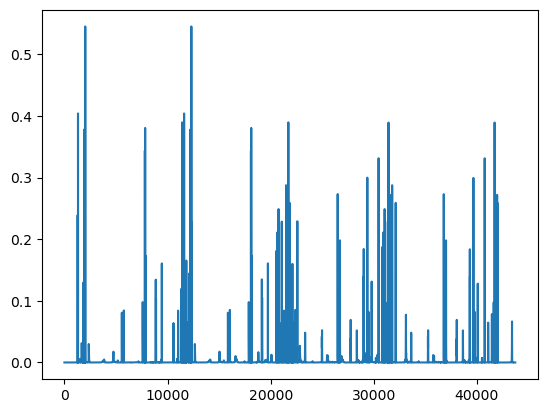

In [139]:
plt.plot(f1B_11A_GR_prob)
#f1B_11A_GR_prob

In [173]:
f11A_gr = normalize_array(df_f11A['GR'][2600:].to_numpy(), 0, 0)

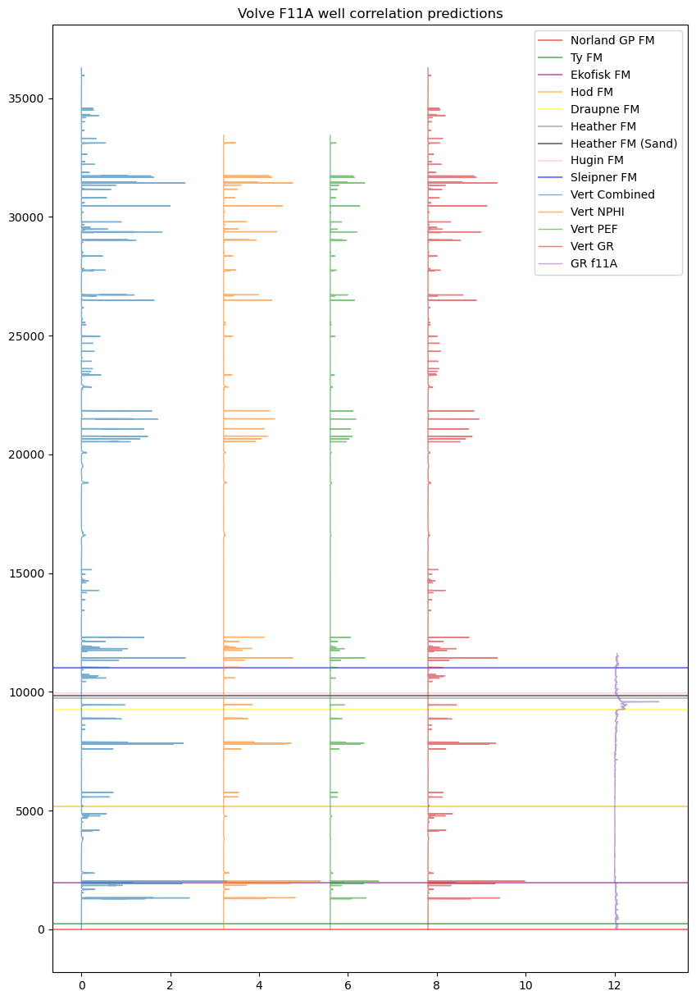

In [175]:
import matplotlib as mpl
#cmap = mpl.colormaps['']
plt.figure(figsize=(10,15))
k=0
for i in f11A_top10:
    plt.axhline(i, alpha=0.5, color=f11A_color[k], label=f11A_FM[k])
    #print(k)
    k=k+1
plt.plot(np.sum(f11A_probmatrix, axis=1), np.arange(len(f11A_probmatrix)), linewidth=1, alpha=.6, label='Vert Combined' )
plt.plot(np.sum(f11A_probmatrixNPHI, axis=1)+3.2, np.arange(len(f11A_probmatrixNPHI)), linewidth=1, alpha=.6, label = 'Vert NPHI' )
#plt.plot(np.sum(f11A_corrmatrixRHOB, axis=1)+0.4, np.arange(len(f11A_corrmatrixRHOB)), linewidth=1, alpha=.6 )
plt.plot(np.sum(f11A_probmatrixPEF, axis=1)+5.6, np.arange(len(f11A_probmatrixPEF)), linewidth=1, alpha=.6, label='Vert PEF')
plt.plot(np.sum(f11A_probmatrixGR, axis=1)+7.8, np.arange(len(f11A_probmatrixGR)), linewidth=1, alpha=.6, label = 'Vert GR' )
plt.plot(f11A_gr+ 12, np.arange(len(f11A_gr)) , linewidth=1, alpha=.6, label='GR f11A')
maxx = len(df_f11A)
f11A_top10 = f11A_tops*10-26000 #25400
plt.title('Volve F11A well correlation predictions')
#f11A_top10
#cmap = plt.colormaps('turbo')


plt.legend(loc='upper right')